In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import math
import scipy
from scipy.special import erf
import numpy
from numpy import exp
from numpy.lib.scimath import log, sqrt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import animation, rc
from IPython.display import HTML

In [2]:
plt.rcParams.update({'font.size': 15})
plt.rcParams["figure.figsize"] = (13, 7)

In [3]:
def plotPath(df, i):
    s=df.path[i]
    a=[int(i) for i in s.split(';')]
    return a

## Exercise 10.01 ##
The travelling salesman problem is a classical problem in combinatorial optimization. MAthematically speaking we are trying to find the shortest hamiltonian path on a simply connected graph, i.e. the shortest path that touches all the edges exactly once. It's a NP-hard problem, and is therefore widely studied and no known algorithm gives the exact solutions, aside from the brute-force method.

We already explored in the previous notebook the use of genetic algorithms to find a solution to the TSP, and we saw that we can reach good result by using genetic algorithm. We now wonder wheter the method may be made more efficient by implementing parallel calculation. Genetic algorithms are naturally parallelizable: each process (from now on a process will be called a continent) use the genetic algorithm to find the best solution, and at some point genetic information is exchanged between continents.

In the next block we show the length of the paths obtained by generating $100$ cities in a square of length $1$, and searching the solution by using a population of $N=1000$ solutions, with a base probability of mutation of $0.1$ and a crossover probability of $0.5$. 4 parallel processes did the same thing: at first we tried to make them randomly exchange genetic data every $10$ generations, and then we did the same thing without the exchange of genetic data.

At every generation the next one is constructed by choosing $N=100$ new walkers according to the law:
$$p(i)=N \lfloor 1-n^{0.5}\rfloor$$
where $n$ is a random number uniformly distributed in $[0,1]$

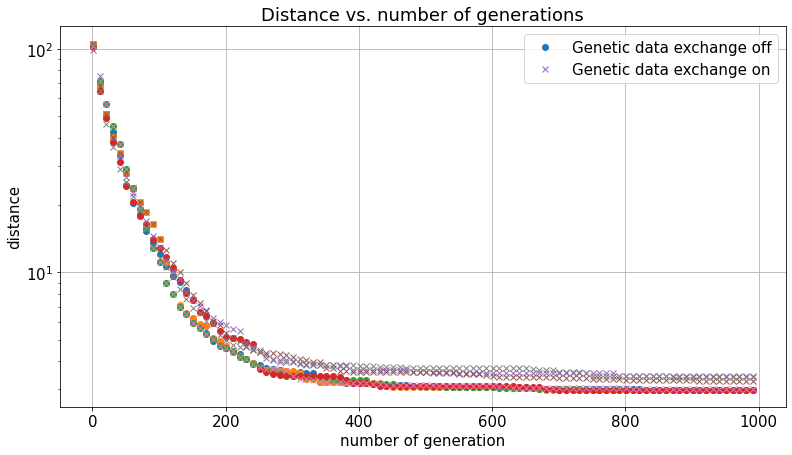

In [4]:
df1=pd.read_csv("./salesmanProblemParallel/parallelSolutions/path1.csv")
df2=pd.read_csv("./salesmanProblemParallel/parallelSolutions/path2.csv")
df3=pd.read_csv("./salesmanProblemParallel/parallelSolutions/path3.csv")
df0=pd.read_csv("./salesmanProblemParallel/parallelSolutions/path0.csv")

plt.plot(df0.length[1::10], 'o',label='Genetic data exchange off')
plt.plot(df1.length[1::10], 'o')
plt.plot(df2.length[1::10], 'o')
plt.plot(df3.length[1::10], 'o')

df1=pd.read_csv("./salesmanProblemParallel/nonParallelSolutions/path1.csv")
df2=pd.read_csv("./salesmanProblemParallel/nonParallelSolutions/path2.csv")
df3=pd.read_csv("./salesmanProblemParallel/nonParallelSolutions/path3.csv")
df0=pd.read_csv("./salesmanProblemParallel/nonParallelSolutions/path0.csv")

plt.plot(df0.length[1::10], 'x',label='Genetic data exchange on')
plt.plot(df1.length[1::10], 'x')
plt.plot(df2.length[1::10], 'x')
plt.plot(df3.length[1::10], 'x')
plt.title('Distance vs. number of generations')
plt.grid()
plt.ylabel('distance')
plt.xlabel('number of generation')
plt.legend()
plt.yscale('log')

Two observations are immediate: the parallelization brought us to a better solutions, but the exchanging of genetic data didn't. One of the processes found in the same time the optimal solution. When the processes can communicate, obviously, the process which find the best solution sends it to the others and in no time every processes has a better solution to work on. This could be a drawback: the purpose of having more than one process is a wider exploration of the space of the solutions, and if all the processes explores in the same direction we can't benefit from having more than one process.
On the other hand, if the solution isn't as immediate as it is in this case this could also be an advantage: by exchanging data we are giving all the processes a more clear direction.

## Case study: US Capitals ##

This time we use a different dataset: the coordinates of the american capitals. We treated them as $x,y$ coordinates, and used the $L^2$ distance between them. This is an approsximation, because the earth is a sphere and the length is the length of the circle arc. The same study as before gives us this results:

In [5]:
dfPath1RP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path1RandomParameter.csv');
dfPath2RP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path2RandomParameter.csv');
dfPath3RP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path3RandomParameter.csv');
dfPath0RP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path0RandomParameter.csv');

dfPath1FP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path1FixedParameter.csv');
dfPath2FP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path2FixedParameter.csv');
dfPath3FP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path3FixedParameter.csv');
dfPath0FP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path0FixedParameter.csv');


dfPath1NP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path1nonParallel.csv');
dfPath2NP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path2nonParallel.csv');
dfPath3NP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path3nonParallel.csv');
dfPath0NP=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/path0nonParallel.csv');

dfCity=pd.read_csv(r'salesmanProblemParallel/capitalsSolutions/city.csv');

In [9]:
fig, axis=plt.subplots(2,1,figsize=(12,12))
axis[0].plot(dfPath0NP.length[1::10],ls='none',marker='o',label='non parallel')
axis[0].plot(dfPath1NP.length[1::10],ls='none',marker='o')
axis[0].plot(dfPath2NP.length[1::10],ls='none',marker='o')
axis[0].plot(dfPath3NP.length[1::10],ls='none',marker='o')

axis[0].plot(dfPath0FP.length[1::10],ls='none',marker='x',label='parallel')
axis[0].plot(dfPath1FP.length[1::10],ls='none',marker='x')
axis[0].plot(dfPath2FP.length[1::10],ls='none',marker='x')
axis[0].plot(dfPath3FP.length[1::10],ls='none',marker='x')
axis[0].set_title('Best path length vs. number of generations, US capitals')
axis[0].grid()
axis[0].set_ylabel(r'L^2 norm of the path')
axis[0].set_xlabel('number of generation')
axis[0].legend()
axis[0].set_yscale('log')

axis[1].plot(dfPath0NP.meanLength[1::10],ls='none',marker='o',label='non parallel')
axis[1].plot(dfPath1NP.meanLength[1::10],ls='none',marker='o')
axis[1].plot(dfPath2NP.meanLength[1::10],ls='none',marker='o')
axis[1].plot(dfPath3NP.meanLength[1::10],ls='none',marker='o')

axis[1].plot(dfPath0FP.meanLength[1::10],ls='none',marker='x',label='parallel')
axis[1].plot(dfPath1FP.meanLength[1::10],ls='none',marker='x')
axis[1].plot(dfPath2FP.meanLength[1::10],ls='none',marker='x')
axis[1].plot(dfPath3FP.meanLength[1::10],ls='none',marker='x')
axis[1].set_title('Mean length vs number of generation, US capitals')
axis[1].grid()
axis[1].set_ylabel(r'$L^2$ norm of the path')
axis[1].set_xlabel('number of generation')
axis[1].legend()
axis[1].set_yscale('log')
plt.tight_layout()

We can magnify in the section $[400,1000]$ to see the difference

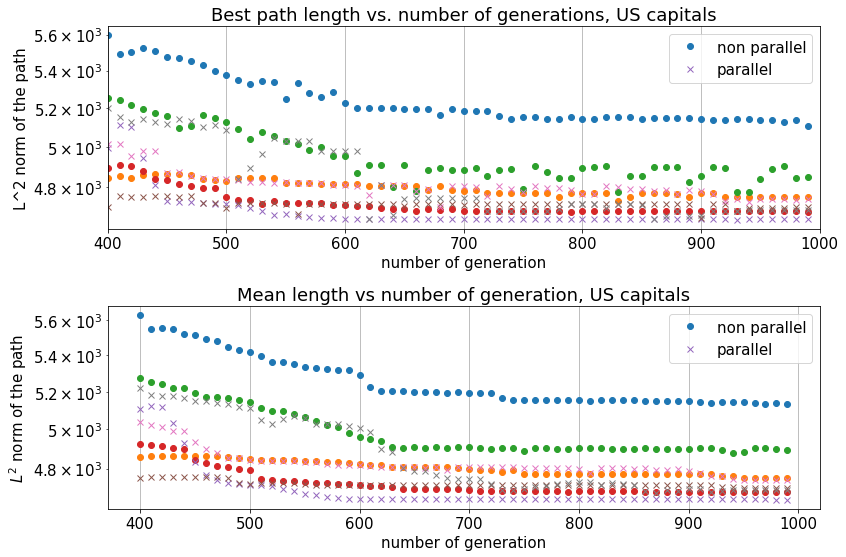

In [16]:
fig, axis=plt.subplots(2,1,figsize=(12,8))
axis[0].plot(dfPath0NP.length[400::10],ls='none',marker='o',label='non parallel')
axis[0].plot(dfPath1NP.length[400::10],ls='none',marker='o')
axis[0].plot(dfPath2NP.length[400::10],ls='none',marker='o')
axis[0].plot(dfPath3NP.length[400::10],ls='none',marker='o')

axis[0].plot(dfPath0FP.length[400::10],ls='none',marker='x',label='parallel')
axis[0].plot(dfPath1FP.length[400::10],ls='none',marker='x')
axis[0].plot(dfPath2FP.length[400::10],ls='none',marker='x')
axis[0].plot(dfPath3FP.length[400::10],ls='none',marker='x')
axis[0].set_title('Best path length vs. number of generations, US capitals')
axis[0].grid()
axis[0].set_ylabel(r'L^2 norm of the path')
axis[0].set_xlabel('number of generation')
axis[0].legend()
axis[0].set_xlim([400,1000])
axis[0].set_yscale('log')

axis[1].plot(dfPath0NP.meanLength[400::10],ls='none',marker='o',label='non parallel')
axis[1].plot(dfPath1NP.meanLength[400::10],ls='none',marker='o')
axis[1].plot(dfPath2NP.meanLength[400::10],ls='none',marker='o')
axis[1].plot(dfPath3NP.meanLength[400::10],ls='none',marker='o')

axis[1].plot(dfPath0FP.meanLength[400::10],ls='none',marker='x',label='parallel')
axis[1].plot(dfPath1FP.meanLength[400::10],ls='none',marker='x')
axis[1].plot(dfPath2FP.meanLength[400::10],ls='none',marker='x')
axis[1].plot(dfPath3FP.meanLength[400::10],ls='none',marker='x')
axis[1].set_title('Mean length vs number of generation, US capitals')
axis[1].grid()
axis[1].set_ylabel(r'$L^2$ norm of the path')
axis[1].set_xlabel('number of generation')
axis[1].legend()
axis[1].set_yscale('log')
plt.tight_layout()

And we can even watch closely the best path obtained to see the differences

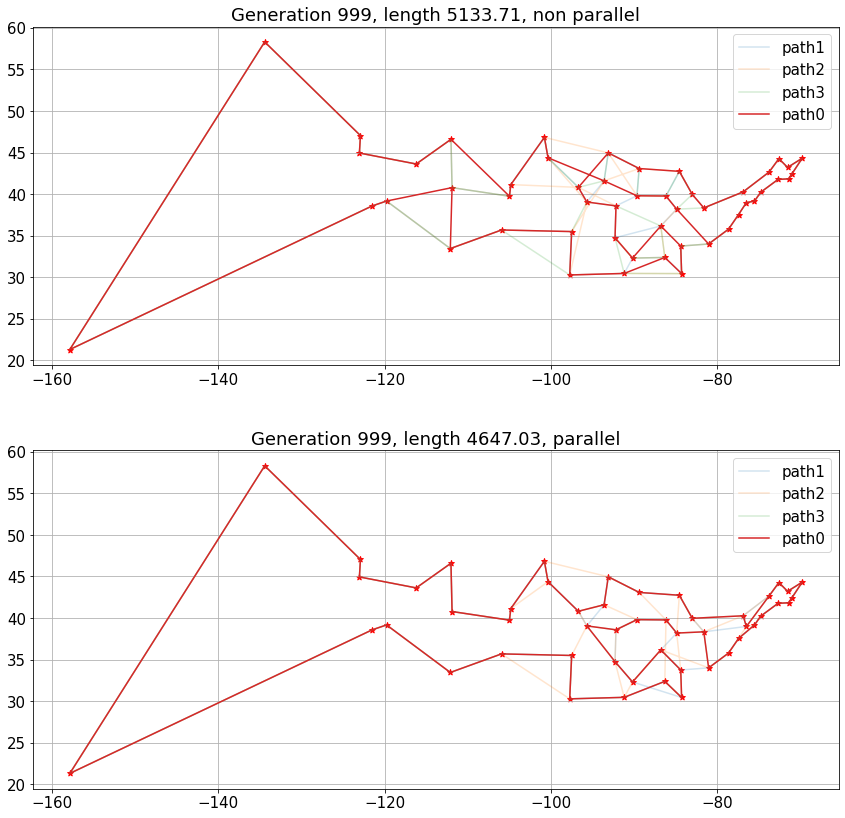

In [17]:
fig, axis = plt.subplots(2,1, figsize=(12,12))
i=999
axis[0].clear()
path=plotPath(dfPath0RP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path1",alpha=0.2)
path=plotPath(dfPath2NP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path2",alpha=0.2)
path=plotPath(dfPath3NP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path3", alpha=0.2)
path=plotPath(dfPath1NP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path0")
axis[0].scatter(dfCity.x,dfCity.y, marker='*', color='red')
axis[0].legend()
axis[0].set_title(f'Generation {i}, length {dfPath0NP.length[i]}, non parallel')
axis[0].set_aspect('equal')
axis[0].grid()

axis[1].clear()
path=plotPath(dfPath0FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path1",alpha=0.2)
path=plotPath(dfPath2FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path2",alpha=0.2)
path=plotPath(dfPath3FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path3", alpha=0.2)
path=plotPath(dfPath1FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path0")
axis[1].scatter(dfCity.x,dfCity.y, marker='*', color='red')
axis[1].legend()
axis[1].set_title(f'Generation {i}, length {dfPath0FP.length[i]}, parallel')
axis[1].set_aspect('equal')
axis[1].grid()
plt.tight_layout()

We see a slight improvement by using parallelization. But we can even do more: the parameters have been tuned by ear, and we didn't conduct a proper study on how to choose them.  Now we can try to use different parameters on different continents: 

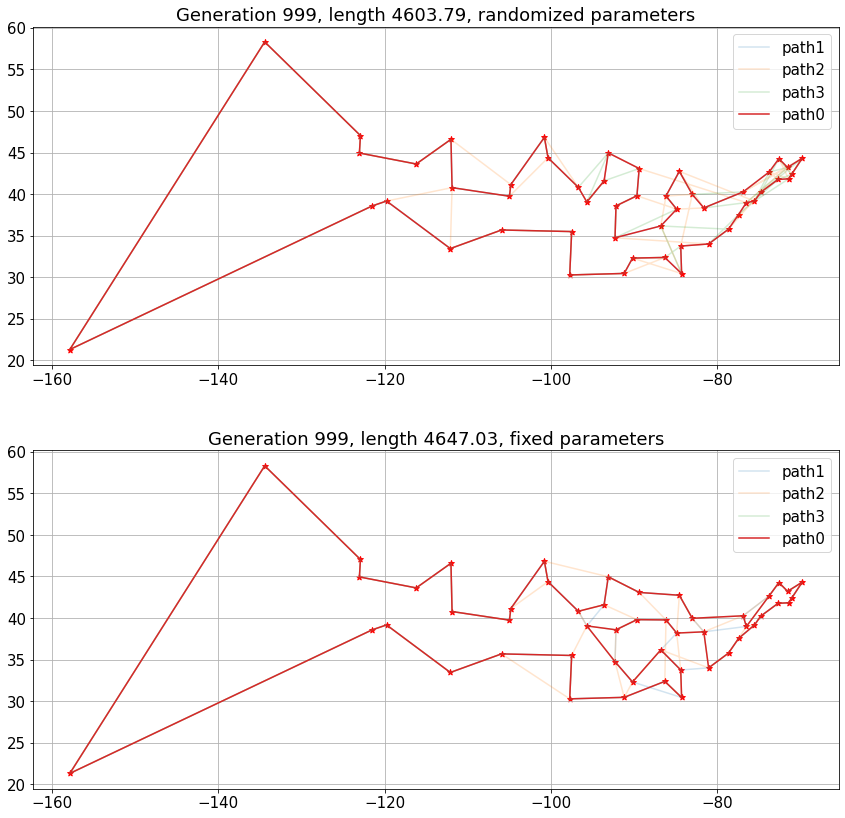

In [18]:
fig, axis = plt.subplots(2,1, figsize=(12,12))
i=999
axis[0].clear()
path=plotPath(dfPath0RP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path1",alpha=0.2)
path=plotPath(dfPath2RP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path2",alpha=0.2)
path=plotPath(dfPath3RP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path3", alpha=0.2)
path=plotPath(dfPath1RP, i)
axis[0].plot(dfCity.x[path],dfCity.y[path],label="path0")
axis[0].scatter(dfCity.x,dfCity.y, marker='*', color='red')
axis[0].legend()
axis[0].set_title(f'Generation {i}, length {dfPath0RP.length[i]}, randomized parameters')
axis[0].set_aspect('equal')
axis[0].grid()

axis[1].clear()
path=plotPath(dfPath0FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path1",alpha=0.2)
path=plotPath(dfPath2FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path2",alpha=0.2)
path=plotPath(dfPath3FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path3", alpha=0.2)
path=plotPath(dfPath1FP, i)
axis[1].plot(dfCity.x[path],dfCity.y[path],label="path0")
axis[1].scatter(dfCity.x,dfCity.y, marker='*', color='red')
axis[1].legend()
axis[1].set_title(f'Generation {i}, length {dfPath0FP.length[i]}, fixed parameters')
axis[1].set_aspect('equal')
axis[1].grid()
plt.tight_layout()

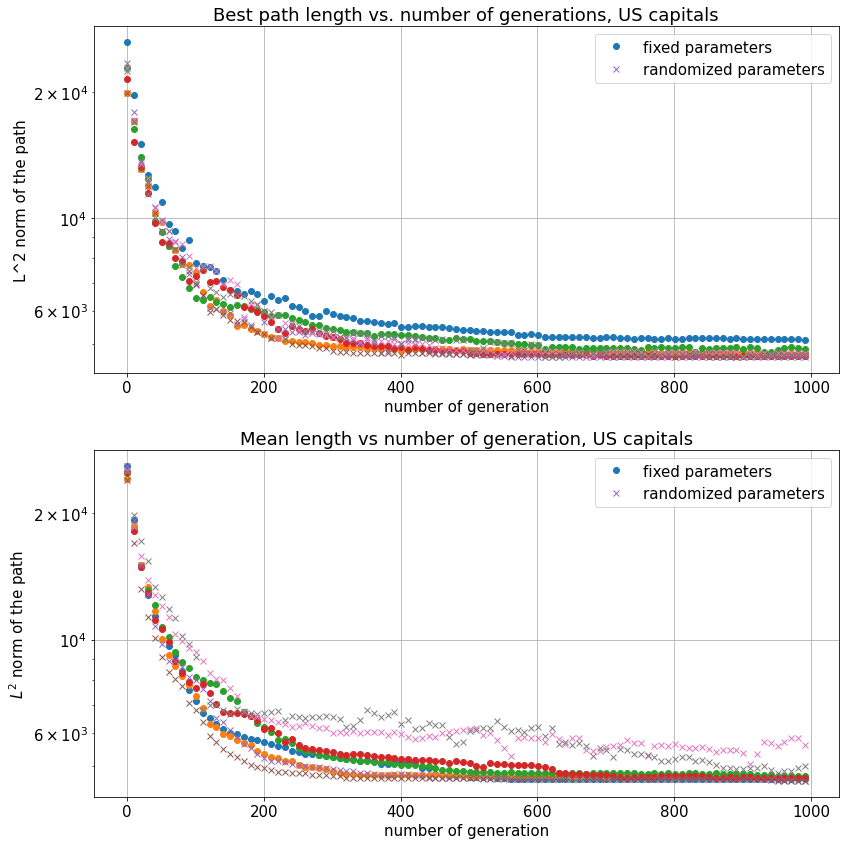

In [19]:
fig, axis=plt.subplots(2,1,figsize=(12,12))
axis[0].plot(dfPath0NP.length[1::10],ls='none',marker='o',label='fixed parameters')
axis[0].plot(dfPath1NP.length[1::10],ls='none',marker='o')
axis[0].plot(dfPath2NP.length[1::10],ls='none',marker='o')
axis[0].plot(dfPath3NP.length[1::10],ls='none',marker='o')

axis[0].plot(dfPath0FP.length[1::10],ls='none',marker='x',label='randomized parameters')
axis[0].plot(dfPath1FP.length[1::10],ls='none',marker='x')
axis[0].plot(dfPath2FP.length[1::10],ls='none',marker='x')
axis[0].plot(dfPath3FP.length[1::10],ls='none',marker='x')
axis[0].set_title('Best path length vs. number of generations, US capitals')
axis[0].grid()
axis[0].set_ylabel(r'L^2 norm of the path')
axis[0].set_xlabel('number of generation')
axis[0].legend()
axis[0].set_yscale('log')

axis[1].plot(dfPath0FP.meanLength[1::10],ls='none',marker='o',label='fixed parameters')
axis[1].plot(dfPath1FP.meanLength[1::10],ls='none',marker='o')
axis[1].plot(dfPath2FP.meanLength[1::10],ls='none',marker='o')
axis[1].plot(dfPath3FP.meanLength[1::10],ls='none',marker='o')

axis[1].plot(dfPath0RP.meanLength[1::10],ls='none',marker='x',label='randomized parameters')
axis[1].plot(dfPath1RP.meanLength[1::10],ls='none',marker='x')
axis[1].plot(dfPath2RP.meanLength[1::10],ls='none',marker='x')
axis[1].plot(dfPath3RP.meanLength[1::10],ls='none',marker='x')
axis[1].set_title('Mean length vs number of generation, US capitals')
axis[1].grid()
axis[1].set_ylabel(r'$L^2$ norm of the path')
axis[1].set_xlabel('number of generation')
axis[1].legend()
axis[1].set_yscale('log')
plt.tight_layout()

As we can see randomizing the parameters bring us to the same result slightly faster. This could help us to tune the parameters in a more sounding way

## Tackling N=500 cities ##
In the previous notebook we tried to solve the problem with $500$ cities, and we didn't manage to do without increasing the size of the population up to $10^4$. Here we try to use 4 different continents, with randomized parameters, to see if we can reach a result in $10^4$ generations

In [63]:
dfPath1=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500/path1.csv');
dfPath2=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500/path2.csv');
dfPath3=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500/path3.csv');
dfPath0=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500/path0.csv');
dfCity=pd.read_csv(r'salesmanProblemParallel/city.csv');
dfPath1N=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500FixedParameters/path1.csv');
dfPath2N=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500FixedParameters/path2.csv');
dfPath3N=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500FixedParameters/path3.csv');
dfPath0N=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500FixedParameters/path0.csv');
dfCityN=pd.read_csv(r'salesmanProblemParallel/parallelSolutions500FixedParameters/city.csv');

In [64]:
%%capture
gens=dfPath1.gen[0:10000:50]
fig, axis = plt.subplots(1,2)
def updateFig(i):
    axis[0].clear()
    path=plotPath(dfPath0, i)
    axis[0].plot(dfCity.x[path],dfCity.y[path],label="path1",alpha=0.2)
    path=plotPath(dfPath2, i)
    axis[0].plot(dfCity.x[path],dfCity.y[path],label="path2",alpha=0.2)
    path=plotPath(dfPath3, i)
    axis[0].plot(dfCity.x[path],dfCity.y[path],label="path3", alpha=0.2)
    path=plotPath(dfPath1, i)
    axis[0].plot(dfCity.x[path],dfCity.y[path],label="path0")
    axis[0].scatter(dfCity.x,dfCity.y, marker='*', color='red')
    axis[0].legend()
    axis[0].set_aspect('equal')
    axis[0].set_title(f'Randomized parameters, generation {i}')
    axis[0].set_aspect('equal')
    axis[0].grid()

    
    axis[1].clear()
    path=plotPath(dfPath0N, i)
    axis[1].plot(dfCityN.x[path],dfCityN.y[path],label="path1",alpha=0.2)
    path=plotPath(dfPath2N, i)
    axis[1].plot(dfCityN.x[path],dfCityN.y[path],label="path2",alpha=0.2)
    path=plotPath(dfPath3N, i)
    axis[1].plot(dfCityN.x[path],dfCityN.y[path],label="path3", alpha=0.2)
    path=plotPath(dfPath1N, i)
    axis[1].plot(dfCityN.x[path],dfCityN.y[path],label="path0")
    axis[1].scatter(dfCityN.x,dfCityN.y, marker='*', color='red')
    axis[1].legend()
    axis[1].set_aspect('equal')
    axis[1].set_title(f'Fixed parameters, generation {i}')
    axis[1].set_aspect('equal')
    axis[1].grid()
    plt.tight_layout()
    plt.suptitle(f'fixed vs randomized parameters, generation {i}')

In [65]:
anim = animation.FuncAnimation(fig, updateFig,frames=gens, interval=1000)
HTML(anim.to_html5_video())

<Figure size 936x504 with 0 Axes>

In [20]:
plt.plot(dfPath0.length[1::100],ls='none',marker='o')
plt.plot(dfPath1.length[1::100],ls='none',marker='o',label='randomized parameters')
plt.plot(dfPath2.length[1::100],ls='none',marker='o')
plt.plot(dfPath3.length[1::100],ls='none',marker='o')

plt.plot(dfPath0N.length[1::100],ls='none',marker='x',label='fixed parameters')
plt.plot(dfPath1N.length[1::100],ls='none',marker='x')
plt.plot(dfPath2N.length[1::100],ls='none',marker='x')
plt.plot(dfPath3N.length[1::100],ls='none',marker='x')
plt.title(r'Best path length vs. number of generations, 500 cities on $[-1,1]\times[-1,1]$')
plt.grid()
plt.ylabel(r'L^2 norm of the path')
plt.xlabel('number of generation')
plt.legend()
plt.yscale('log')

NameError: name 'dfPath0' is not defined

## Conclusion ##
A joke attributed to Fred Brooks goes:"What one programmer can do in one month, two programmers can do in two months."
In this notebook we experienced a similar problem: we had functioning software from the previous notebook and by adding more processors we slowed down the computations to obtain the same results.
The key takeaway is that adding more core and more processor isn't always related to an increse in performance. We have to manage the different processes and their communication, and this may result overall slower than a single process.

What we implemented here is obviously a naive parallel programming: most routines are synchronous, there is no support for the object, and the hardware isn't even tuned to do this: we are using a Windows personal computer, and the processes are managed by the OS, so we don't even know if they are running in parallel.